In [196]:
import os
import requests
import psycopg2
import webbrowser
import msal
import os
import imageio
import io

In [197]:
SCOPES = ['User.Read','Mail.Read', 'Mail.Send']
APP_ID ='a7c0a132-7332-4d7e-a59b-879f4d227bcb'

In [198]:
def generate_access_token(app_id, scopes):
    access_token_cache = msal.SerializableTokenCache()
    if os.path.exists('api_token_access_arp.json'):
        access_token_cache.deserialize(open('api_token_access_arp.json', 'r').read())

    client = msal.PublicClientApplication(client_id=app_id, token_cache=access_token_cache)

    accounts = client.get_accounts()
    if accounts: 
        token_response = client.acquire_token_silent(scopes, account=accounts[0])
    else:
        flow = client.initiate_device_flow(scopes=scopes)
        print('User code :' + flow['user_code'])
        webbrowser.open(flow['verification_uri'])
        token_response = client.acquire_token_by_device_flow(flow)

    with open('api_token_access_arp.json', 'w') as _f:
        _f.write(access_token_cache.serialize())
    return token_response

In [199]:
def get_emails(access_token):
    endpoint = "https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=isRead eq false&$top=1000"

    headers = {
        'Authorization': f'Bearer {access_token}'
    }
    response = requests.get(endpoint, headers=headers)
    if response.status_code == 200:
        emails = response.json()
        return emails.get('value', [])
    else:
        raise Exception(f"Error fetching emails: {response.status_code} - {response.text}")

In [200]:
token_response = generate_access_token(APP_ID, SCOPES)
access_token = token_response['access_token']

In [201]:
emails = get_emails(access_token)

[{'@odata.etag': 'W/"CQAAABYAAACY28Rccs6eQ6vSFsjSkG/hAAD+USbO"',
  'id': 'AAMkADZmMjNiMDJjLTUzNDItNDJiZS1iOTkxLTQ3NGFhOTE0OGEwZABGAAAAAACmpm51Pxn4S6hR8gC58iFDBwCY28Rccs6eQ6vSFsjSkG-hAAAAAAEMAACY28Rccs6eQ6vSFsjSkG-hAAD_u4e0AAA=',
  'createdDateTime': '2024-07-03T02:32:25Z',
  'lastModifiedDateTime': '2024-07-03T02:37:43Z',
  'changeKey': 'CQAAABYAAACY28Rccs6eQ6vSFsjSkG/hAAD+USbO',
  'categories': [],
  'receivedDateTime': '2024-07-03T02:32:25Z',
  'sentDateTime': '2024-07-03T02:32:08Z',
  'hasAttachments': False,
  'internetMessageId': '<71ce9fee-38e4-11ef-9b53-d93aa981cf2a@mail.instagram.com>',
  'subject': 'surgicalaesthetics411, see Shruti Haasan, devon windsor and more in your feed',
  'bodyPreview': 'Follow Shruti Haasan, devon windsor and others you know to see their photos and videos.\r\n\r\nOpen Instagram\r\n\r\nShruti Haasan\r\n\r\nSuggested for you\r\n\r\nView\r\n\r\ndevon windsor\r\n\r\nSuggested for you\r\n\r\nView\r\n\r\nAlexis Ren\r\n\r\nSuggested for you\r\n\r\nView\r\n\r
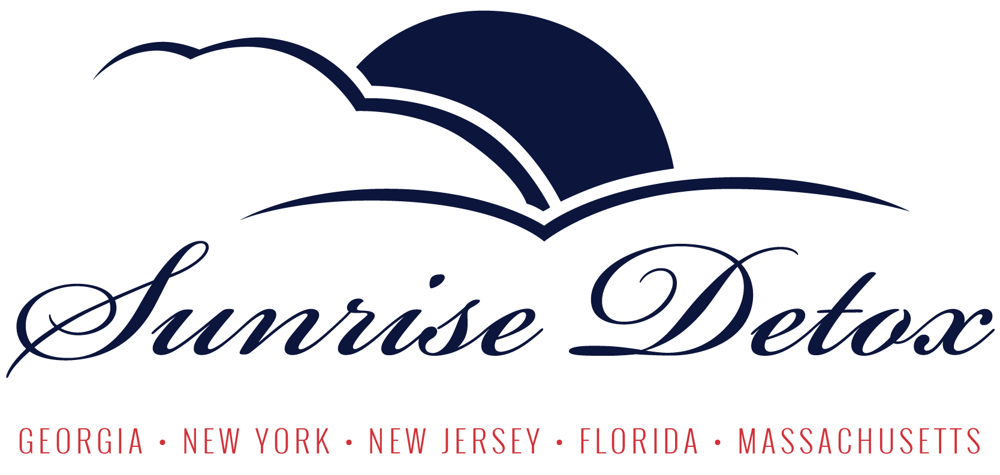
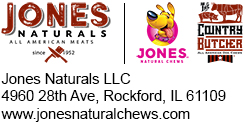

In [202]:
emails

In [73]:
len(emails)

1000

In [74]:
from bs4 import BeautifulSoup

def extract_text_from_html(html_content):
    # Parse the HTML content
    soup = BeautifulSoup(html_content, 'html.parser')

    # Extract text from the parsed HTML
    text_content = soup.get_text()
    return text_content

In [75]:
def process_emails(emails):
    data = []
    count = 0  # Initialize the counter
    for email in emails:
        subject = email['subject']
        if "Message Failure" in subject or "Undeliverable" in subject:
            raw_email_body = email['body']['content']
            email_body = extract_text_from_html(raw_email_body)
            sender_address = email['sender']['emailAddress']['address']
            email_id = email['changeKey']
            received_info = email['receivedDateTime']
            send_info = email['sentDateTime']
            # Store the extracted information in a dictionary
            email_data = {
                "Subject": subject,
                "Email_body": email_body,
                "Sender": sender_address,
                "ID": email_id,
                "Receie_Data_Time": received_info,
                "send_Date_Time": send_info
            }
            # Append the dictionary to the data list
            data.append(email_data)
            count += 1  # Increment the counter
    return data, count  # Return the data list and the counter

# Main function
def main():
    emails = get_emails(access_token)
    email_data, count = process_emails(emails)
    for item in email_data:
        print(f"Subject: {item['Subject']}")
        print(f"Body: {item['Email_body']}")
        print(f"Sender: {item['Sender']}")
        print(f"ID: {item['ID']}")
        print(f"Receie_Data_Time: {item['Receie_Data_Time']}")
        print(f"send_Date_Time: {item['send_Date_Time']}")
        print("----------")
    print(f"Total number of processed emails: {count}")  # Print the count

if __name__ == "__main__":
    main()


Subject: Message Failure: New CASE Policy: Enhancing Success with Universal Design for Learning!
Body: 
Your message could not be delivered. The reason for the failure and the original message appear below.Reason: The account for user, nfrerking@concordia.k12.mo.us, has been warehoused. [Error Code = 550]Original Message:


    
    
    
    

    
    
        
        
    
     Discover how Universal Design for Learning supports inclusive education for all students, including those with disabilities...͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ 

In [13]:


# # Example usage:
# email_body = '<html><head>\r\n<meta http-equiv="Content-Type" content="text/html; charset=utf-8"></head><body><p>Thank you for reaching out.</p><p>As of November 10th, Saj is no longer with Great Exposure and CampusLogin. This message is to guide you to the appropriate contact for assistance.</p><p><strong>For USA-based inquiries:</strong></p><ul><li>Clients and product inquiries: Contact Daniel Sutherland at Sutherland@GreatExposure.com or your Account Manager.</li><li>Accounts Receivable: Email Accounting@GreatExposure.com</li><li>College Associations, Professional Alliances, Accounts Payable: Reach out to Michael Katz at Katz@GreatExposure.com</li></ul><p><strong>For Canada-based inquiries:</strong></p><ul><li>Clients and product inquiries: Contact Myke Ames at Ames@GreatExposure.com or your Account Manager.</li><li>Accounts Receivable: Email Accounting@GreatExposure.com</li><li>College Associations, Professional Alliances, Accounts Payable: Reach out to Michael Katz at Katz@GreatExposure.com</li></ul><p>For urgent escalations or general contact, please email Michael Katz directly.</p><p>We appreciate your inquiry and look forward to assisting you.</p><p>Great Exposure Inc</p>TORONTO - HEAD OFFICE 951 Wilson Ave, Unit 18U Toronto, ON, Canada, M3K 2A7 <p><img src="https://www2.campuslogin.com/Files/CkUploaded/900/images/GE-CL-signature-animation.gif"> </p></body></html>'

# # Extract text from email body
# extracted_text = extract_text_from_html(email_body)

# # Print the extracted text
# print(extracted_text)


In [44]:
# def save_file_with_increment(image_data, file_name):
#     base_name, ext = os.path.splitext(file_name)
#     counter = 1
#     new_file_name = file_name
    
#     # Check if the file already exists and find an appropriate file name
#     while os.path.exists(new_file_name):
#         new_file_name = f"{base_name}_{counter}{ext}"
#         counter += 1
    
#     # Save the file with the new file name
#     with open(new_file_name, 'wb') as file:
#         file.write(image_data)
#         print(f"File {new_file_name} downloaded and saved.")

# GRAPH_API_ENDPOINT = 'https://graph.microsoft.com/v1.0'
# headers = {
#     'Authorization': f'Bearer {access_token}'
# }
# for i in emails:
#     ID = i['id']
#     message_id =ID #'AQMkAGYxODFjNmYwLWE3M2UtNDFlMy1iOGY1LTkzMwE4NmQxYzU2NABGAAADpY3FPOY_7kiQDKfUAhHkpwcAOEwgUw2U7UmnPxNFBCNS_gAAAgEMAAAAOEwgUw2U7UmnPxNFBCNS_gABP525TgAAAA=='
#     response = requests.get(GRAPH_API_ENDPOINT + f'/me/messages/{message_id}/attachments', headers=headers)
#     print(response)
#     # print(response.json())
#     attachment_items = response.json().get('value', [])
#     for attachment in attachment_items:
#         file_name = attachment.get('name', '')
#         attachment_id = attachment.get('id', '')
#         content_type = attachment.get('@odata.mediaContentType', '')
#         change_key = attachment.get('parentMessage', {}).get('changeKey', '')
#         attachment_content_response = requests.get(GRAPH_API_ENDPOINT + f'/me/messages/{message_id}/attachments/{attachment_id}/$value',headers=headers)
#         attachment_content_response
#         image_data = attachment_content_response.content
#         print(image_data)
#         # Save the attachment
#         # Save the attachment with a unique name
        
#         save_file_with_increment(image_data, file_name)


In [76]:
# import requests

# headers = {
#     'Authorization': f'Bearer {access_token}',
#     'Accept': 'application/json'
# }

# # Define a function to get messages with pagination
# def get_messages(next_link=None):
#     if next_link is None:
#         url = 'https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=isRead eq false&$top=1000'
#     else:
#         url = next_link

#     response = requests.get(url, headers=headers)
#     messages = response.json()
    
#     return messages

# # Start fetching emails
# messages = get_messages()
# all_messages = messages.get('value', [])

# # Continue fetching emails until there's no more nextLink
# while '@odata.nextLink' in messages:
#     next_link = messages['@odata.nextLink']
#     messages = get_messages(next_link)
#     all_messages.extend(messages.get('value', []))

# print(f'Retrieved {len(all_messages)} messages')


In [77]:
# def get_messages(next_link=None):
#     if next_link is None:
#         url = "https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=isRead eq false&$receivedDateTime lt 2024-03-01T00:00:00Z"
#     else:
#         url = next_link

#     response = requests.get(url, headers=headers)
#     messages = response.json()
    
#     return messages

# messages = get_messages()
# all_messages = messages.get('value', [])

# while '@odata.nextLink' in messages:
#     next_link = messages['@odata.nextLink']
#     messages = get_messages(next_link)
#     all_messages.extend(messages.get('value', []))

# print(f'Retrieved {len(all_messages)} messages')

In [204]:
import requests
import json
from datetime import datetime

# Step 2: Fetching Emails
headers = {
    'Authorization': f'Bearer {access_token}',
    'Accept': 'application/json'
}

def get_messages(next_link=None):
    if next_link is None:
        url = "https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=isRead eq false&$top=1000"
    else:
        url = next_link

    response = requests.get(url, headers=headers)
    messages = response.json()
    
    return messages

messages = get_messages()
all_messages = messages.get('value', [])

while '@odata.nextLink' in messages:
    next_link = messages['@odata.nextLink']
    messages = get_messages(next_link)
    all_messages.extend(messages.get('value', []))

print(f'Retrieved {len(all_messages)} messages')

# Save messages to JSON file
with open('emails.json', 'w') as f:
    json.dump(all_messages, f, indent=4)

print('All messages saved to emails.json')


Retrieved 0 messages
All messages saved to emails.json


### Api for unique mails

In [112]:
with open('emails.json', 'r') as f:
    all_messages = json.load(f)

lst_of_all_sender_mails = []
for set_of_from_mails in all_messages:
    sender_mail_id = set_of_from_mails['sender']['emailAddress']['address']
    lst_of_all_sender_mails.append(sender_mail_id)


lst_of_unique_sender_mails= set(lst_of_all_sender_mails)
len(lst_of_unique_sender_mails)

with open("Unique_sender_mail_ids.txt",'w') as f:
    for unique_emails in lst_of_unique_sender_mails:
        f.write(unique_emails + '\n')

369

In [122]:
def post_upload_emails():
    lst_of_all_sender_mails = []
    messages = get_messages()
    all_messages = messages.get('value', [])

    while '@odata.nextLink' in messages:
        next_link = messages['@odata.nextLink']
        messages = get_messages(next_link)
        all_messages.extend(messages.get('value', []))

    for set_of_from_mails in all_messages:
        sender_mail_id = set_of_from_mails['sender']['emailAddress']['address']
        lst_of_all_sender_mails.append(sender_mail_id)
    
    print("1", lst_of_all_sender_mails)
    lst_of_unique_sender_mails = set(lst_of_all_sender_mails)
    print("2", lst_of_unique_sender_mails)
    
    return len(lst_of_unique_sender_mails)


In [123]:
post_upload_emails()

1 ['contact@t.brevo.com', 'txoga@associationrevenuepartners.com', 'wquow@cwsasvg.com', 'genebeck@sweettoothfamilydental.com', 'golnar.jahanmir@nih.gov', 'cdion@pmoisson.com', 'francesca@gm-piccoli.com', 'contact@sendinblue.com', 'contact@sendinblue.com', 'bocesspamnotifications@nasboces.org', 'bocesspamnotifications@nasboces.org', 'bradp@ccwsa.com', 'txoga@associationrevenuepartners.com', 'ibpsa@associationrevenuepartners.com', 'aocoo-hns@associationrevenuepartners.com', 'txoga@associationrevenuepartners.com', 'wsae@associationrevenuepartners.com', 'ava@associationrevenuepartners.com', 'aic@associationrevenuepartners.com', 'mitchellyoungandersonmuseum@yahoo.com', 'txoga@associationrevenuepartners.com', 'katarzyna.orlicka@umontreal.ca', 'm.cicala@unicampus.it', 'berardino.vaira@unibo.it', 'luigi.ricciardiello@unibo.it', 'lfriedman@mgb.org', 'noreply@wiley-epic.com', 'minnie.delascarreras@hotmail.com', 'txoga@associationrevenuepartners.com', 'genebeck@sweettoothfamilydental.com', 'golnar

369

In [6]:
def get_emails(access_token):
    # endpoint = "https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=isRead eq true&$top=100"
    endpoint = "https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=receivedDateTime lt 2024-07-02T14:30:00Z"
    headers = {
        'Authorization': f'Bearer {access_token}'
    }
    emails = []
    while endpoint:
        response = requests.get(endpoint, headers=headers)
        if response.status_code == 200:
            data = response.json()
            emails.extend(data.get('value', []))
            endpoint = data.get('@odata.nextLink')  # Get the nextLink if present
        else:
            raise Exception(f"Error fetching emails: {response.status_code} - {response.text}")
    # response = requests.get(endpoint, headers=headers)
    # if response.status_code == 200:
    #     emails = response.json()
    #     return emails.get('value', [])
    # else:
    #     raise Exception(f"Error fetching emails: {response.status_code} - {response.text}")
    return emails

In [7]:
e = get_emails(access_token)

In [8]:
len(e)


2458

In [12]:
sender_mail_id = set_of_from_mails['sender']#['emailAddress']#['address']
sender_mail_id

{'emailAddress': {'name': 'Industry411 - HR via OnlineDocs'}}

In [13]:
lst_of_all_sender_mails = []

for set_of_from_mails in e:
    try:
        sender_mail_id = set_of_from_mails['sender']['emailAddress']['address']
        lst_of_all_sender_mails.append(sender_mail_id)
    except KeyError:
        pass  # Handle the case where the key does not exist

lst_of_unique_sender_mails = set(lst_of_all_sender_mails)

with open("Unique_sender_mail_ids.txt", 'w') as f:
    for unique_emails in lst_of_unique_sender_mails:
        f.write(unique_emails + '\n')


## just for test

In [14]:
lst_of_all_sender_mails = []

for set_of_from_mails in e:
    try:
        sender_mail_id = set_of_from_mails['sender']['emailAddress']['address']
        lst_of_all_sender_mails.append(sender_mail_id)
    except KeyError:
        pass  # Handle the case where the key does not exist

# Add the new email
lst_of_all_sender_mails.append("krishnagupta4135@gmail.com")

# Convert to a set to get unique email addresses
lst_of_unique_sender_mails = set(lst_of_all_sender_mails)

with open("Unique_sender_mail_ids.txt", 'w') as f:
    for unique_emails in lst_of_unique_sender_mails:
        f.write(unique_emails + '\n')


In [91]:
sender_mails =[]
for email in emails:
    raw_email_body = email['body']['content']
    email_body = extract_text_from_html(raw_email_body)
    subject = email['subject']
    if "Message Failure" in subject or "Undeliverable" in subject:
        get_sender_mail = email['sender']['emailAddress']['address']
        sender_mails.append(get_sender_mail)


/tmp/ipykernel_9497/991565674.py:5: MarkupResemblesLocatorWarning: The input looks more like a filename than markup. You may want to open this file and pass the filehandle into Beautiful Soup.
  soup = BeautifulSoup(html_content, 'html.parser')


In [92]:
len(sender_mails)

149

In [32]:
headers = {
        'Authorization': f'Bearer {access_token}'
    }

In [55]:
req = requests.get('https://graph.microsoft.com/v1.0/me/mailFolders/archive/messages',headers=headers)

In [56]:
req.json()

{'@odata.context': "https://graph.microsoft.com/v1.0/$metadata#users('198161cd-1b05-4ee1-9da2-0a833520a860')/mailFolders('archive')/messages",
 'value': []}

In [ ]:
# https://staging.jsjdmedia.com/api/get-filter

# post method 

# {"emailList": [{"0": "ddw@arpnewsletters.com"}]}


# [{"mailto:0":"ddw@arpnewsletters.com","filterData":[{"id":1,"emailId":1,"filterId":1,"tableId":1,"is_active":1,"deleted_at":null,"created_at":"2024-07-02T09:49:23.000000Z","updated_at":"2024-07-02T09:49:23.000000Z","tableInfo":{"id":1,"tableName":"Recipient Not Found"},"filterInfo":{"id":1,"filterName":"Recipient Not Found","filterOnSubject":1,"filterOnBody":1,"is_active":1}},{"id":2,"emailId":1,"filterId":1,"tableId":2,"is_active":1,"deleted_at":null,"created_at":"2024-07-02T09:49:23.000000Z","updated_at":"2024-07-02T09:49:23.000000Z","tableInfo":{"id":2,"tableName":"Unsubscribe"},"filterInfo":{"id":1,"filterName":"Recipient Not Found","filterOnSubject":1,"filterOnBody":1,"is_active":1}}]}]


# response ye aayega

In [ ]:
{"emailList": [{"1": "ddw@arpnewsletters.com"},{"1":"mailer-daemon@gaggle.net"},{"1":"postmaster@nationpizza.com"}]}

In [121]:
import requests
import json

url = "https://staging.jsjdmedia.com/api/get-filter"

payload = {
    "emailList": [
        {"0": "ddw@arpnewsletters.com"},{"1":"mailer-daemon@gaggle.net"}
    ]
}
headers = {
    "Content-Type": "application/json"
}

response = requests.post(url, json=payload, headers=headers)

if response.status_code == 200:
    try:
        response_data = response.json()
        print("Request was successful.")
        print(json.dumps(response_data, indent=4)) 
    except json.JSONDecodeError:
        print("Response content is not valid JSON")
else:
    print(f"Request failed with status code {response.status_code}.")
    print("Response:", response.text)


Request was successful.
[
    {
        "0": "ddw@arpnewsletters.com",
        "filterData": [
            {
                "id": 1,
                "emailId": 1,
                "filterId": 1,
                "tableId": 1,
                "is_active": 1,
                "deleted_at": null,
                "created_at": "2024-07-02T09:49:23.000000Z",
                "updated_at": "2024-07-02T09:49:23.000000Z",
                "tableInfo": {
                    "id": 1,
                    "tableName": "Recipient Not Found"
                },
                "filterInfo": {
                    "id": 1,
                    "filterName": "Recipient Not Found",
                    "filterOnSubject": 1,
                    "filterOnBody": 1,
                    "is_active": 1
                }
            },
            {
                "id": 2,
                "emailId": 1,
                "filterId": 1,
                "tableId": 2,
                "is_active": 1,
                "delet

In [123]:
# Extract and display filter names for each email ID
for entry in response_data:
    email = entry.get('0') or entry.get('1')  # Extract email ID from keys '0' or '1'
    print(f"Email ID: {email}")
    print("Filters:")
    for filter_data in entry['filterData']:
        filter_name = filter_data['filterInfo']['filterName']
        print(f"- {filter_name}")
    print()

Email ID: ddw@arpnewsletters.com
Filters:
- Recipient Not Found
- Recipient Not Found

Email ID: mailer-daemon@gaggle.net
Filters:
- Message Failure:
- Undeliverable:



In [122]:
filterinfo_lst = []
for i in response_data:
    print(i)
    

{'0': 'ddw@arpnewsletters.com', 'filterData': [{'id': 1, 'emailId': 1, 'filterId': 1, 'tableId': 1, 'is_active': 1, 'deleted_at': None, 'created_at': '2024-07-02T09:49:23.000000Z', 'updated_at': '2024-07-02T09:49:23.000000Z', 'tableInfo': {'id': 1, 'tableName': 'Recipient Not Found'}, 'filterInfo': {'id': 1, 'filterName': 'Recipient Not Found', 'filterOnSubject': 1, 'filterOnBody': 1, 'is_active': 1}}, {'id': 2, 'emailId': 1, 'filterId': 1, 'tableId': 2, 'is_active': 1, 'deleted_at': None, 'created_at': '2024-07-02T09:49:23.000000Z', 'updated_at': '2024-07-02T09:49:23.000000Z', 'tableInfo': {'id': 2, 'tableName': 'Unsubscribe'}, 'filterInfo': {'id': 1, 'filterName': 'Recipient Not Found', 'filterOnSubject': 1, 'filterOnBody': 1, 'is_active': 1}}]}
{'1': 'mailer-daemon@gaggle.net', 'filterData': [{'id': 3, 'emailId': 2, 'filterId': 3, 'tableId': 4, 'is_active': 1, 'deleted_at': None, 'created_at': '2024-07-02T11:32:27.000000Z', 'updated_at': '2024-07-02T11:32:27.000000Z', 'tableInfo': {

In [65]:
payload

{'emailList': [{'0': 'ddw@arpnewsletters.com'}]}

In [70]:
import os
import requests
import webbrowser
import msal
import json

SCOPES = ['User.Read', 'Mail.Read', 'Mail.Send']
APP_ID = 'a7c0a132-7332-4d7e-a59b-879f4d227bcb'


def generate_access_token(app_id, scopes):
    access_token_cache = msal.SerializableTokenCache()
    if os.path.exists('api_token_access_arp.json'):
        access_token_cache.deserialize(open('api_token_access_arp.json', 'r').read())

    client = msal.PublicClientApplication(client_id=app_id, token_cache=access_token_cache)

    accounts = client.get_accounts()
    if accounts:
        token_response = client.acquire_token_silent(scopes, account=accounts[0])
    else:
        flow = client.initiate_device_flow(scopes=scopes)
        print('User code: ' + flow['user_code'])
        webbrowser.open(flow['verification_uri'])
        token_response = client.acquire_token_by_device_flow(flow)

    with open('api_token_access_arp.json', 'w') as _f:
        _f.write(access_token_cache.serialize())
    return token_response


def get_emails(access_token):
    endpoint = "https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=receivedDateTime lt 2024-07-02T14:30:00Z"
    headers = {
        'Authorization': f'Bearer {access_token}'
    }
    emails = []
    while endpoint:
        response = requests.get(endpoint, headers=headers)
        if response.status_code == 200:
            data = response.json()
            emails.extend(data.get('value', []))
            endpoint = data.get('@odata.nextLink')  # Get the nextLink if present
        else:
            raise Exception(f"Error fetching emails: {response.status_code} - {response.text}")
    return emails


def post_upload_emails(access_token):
    emails = get_emails(access_token)
    lst_of_all_sender_mails = []
    for set_of_from_mails in emails:
        try:
            sender_mail_id = set_of_from_mails['sender']['emailAddress']['address']
            lst_of_all_sender_mails.append(sender_mail_id)
        except KeyError:
            pass  # Handle the case where the key does not exist

    # Ensure 'ddw@arpnewsletters.com' is added as the first email
    lst_of_all_sender_mails.insert(0, 'ddw@arpnewsletters.com')

    lst_of_unique_sender_mails = set(lst_of_all_sender_mails)

    # Create payload in the desired format
    payload = {
        "emailList": [{str(i): email} for i, email in enumerate(lst_of_unique_sender_mails)]
    }

    headers = {
        "Content-Type": "application/json"
    }
    print(payload)
    response = requests.post("https://staging.jsjdmedia.com/api/get-filter", json=payload, headers=headers)
    if response.status_code == 200:
        print("POST request was successful.")
        print("Response:", json.dumps(response.json(), indent=4))
    else:
        print(f"POST request failed with status code {response.status_code}.")
        print("Response:", response.text)

    return len(lst_of_unique_sender_mails)


def main():
    token_response = generate_access_token(APP_ID, SCOPES)
    access_token = token_response['access_token']

    # Get emails and post them
    unique_email_count = post_upload_emails(access_token)
    print(f"Number of unique sender emails: {unique_email_count}")


if __name__ == "__main__":
    main()


{'emailList': [{'0': 'jen@wflegal.law'}, {'1': 'ichemin@biosynex.com'}, {'2': 'system@sent-via.netsuite.com'}, {'3': 'account-alerts@sendinblue.com'}, {'4': 'mbutler@weaversofwellsville.com'}, {'5': 'morgan@cosa.k12.or.us'}, {'6': 'dschmidt@marinebank.bank'}, {'7': 'j.bickersteth@icsconservation.com'}, {'8': 'randomuser@nifty.com'}, {'9': 'e.espinet@ub.edu'}, {'10': 'aic@associationrevenuepartners.com'}, {'11': 'cedric.pascual@demeco-group.com'}, {'12': 'humail@theradiag.com'}, {'13': 'noreply@wiley-epic.com'}, {'14': 'nhung@nime.co.jp'}, {'15': 'dharris@associationeg.com'}, {'16': 'appa@associationrevenuepartners.com'}, {'17': 'gseamer@booksinc.net'}, {'18': 'Paul.Kan@gov.bc.ca'}, {'19': 'mec89@stanford.edu'}, {'20': 'karendimick@roadrunner.com'}, {'21': 'Allison.peterson@saltydonut.com'}, {'22': 'Martin.Bartyzal@ellacs.eu'}, {'23': 'bill.lorenz@creteschools.org'}, {'24': 'iafc@associationrevenuepartners.com'}, {'25': 'h_d_sparky@hotmail.com'}, {'26': 'swstrmann@gmail.com'}, {'27': 'p

In [71]:
test = {"emailList": [{"1": "ddw@arpnewsletters.com"},{"1":"mailer-daemon@gaggle.net"},{"1":"postmaster@nationpizza.com"}]}

In [72]:
test

{'emailList': [{'1': 'ddw@arpnewsletters.com'},
  {'1': 'mailer-daemon@gaggle.net'},
  {'1': 'postmaster@nationpizza.com'}]}

In [79]:
for i in test:
   a = i[0]
print(a)

e


In [85]:
test = {"emailList": [{"1": "ddw@arpnewsletters.com"},{"1":"mailer-daemon@gaggle.net"},{"1":"postmaster@nationpizza.com"}]}
first_emails = [entry["1"] for entry in test["emailList"]]
print(first_emails)


['ddw@arpnewsletters.com', 'mailer-daemon@gaggle.net', 'postmaster@nationpizza.com']


### Test

In [164]:
import json
import msal
import requests
import webbrowser
import os
# import boto3
import pandas as pd
import mysql.connector
from mysql.connector import Error, IntegrityError
from sqlalchemy import create_engine
import logging
from datetime import datetime

# Set up logging
logger = logging.getLogger()
logger.setLevel(logging.INFO)

# Constants for OAuth2.0 authentication and API access
SCOPES = ['User.Read','Mail.Read']
# APP_ID = '6bed9aa0-273d-459a-96b5-0ef657c3a6ee'
APP_ID = 'a7c0a132-7332-4d7e-a59b-879f4d227bcb'
# APP_ID = '01ab377f-53b7-41a4-a0d1-2dd7c16a3d7f'
base_tmp_path = "/tmp/"


# Get current UTC time
current_utc_time = datetime.utcnow()

# Format to ISO 8601 string
formatted_time = current_utc_time.strftime('%Y-%m-%dT%H:%M:%SZ')

def generate_access_token(app_id, scopes):
    # Initialize the token cache
    access_token_cache = msal.SerializableTokenCache()
    local_filename_initial = 'api_token_access_arp.json'
    filename = 'api_token_access_arp.json'
    local_file_path = f'{base_tmp_path}{filename}'

    # Load token cache from file if it exists
    if os.path.exists(local_filename_initial):
        access_token_cache.deserialize(open(local_filename_initial, 'r').read())

    # Create MSAL public client application
    client = msal.PublicClientApplication(client_id=app_id, token_cache=access_token_cache)
    accounts = client.get_accounts()

    # Try to acquire token silently
    if accounts:
        token_response = client.acquire_token_silent(scopes, account=accounts[0])
    else:
        # Initiate device flow if no accounts are found
        flow = client.initiate_device_flow(scopes=scopes)
        print('User code :' + flow['user_code'])
        webbrowser.open(flow['verification_uri'])
        token_response = client.acquire_token_by_device_flow(flow)

    # Save the updated token cache to a file
    with open(local_file_path, 'w') as _f:
        _f.write(access_token_cache.serialize())

    return token_response



# Function to get unread emails
def get_emails(access_token):
    endpoint = "https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=isRead eq false&$top=1000"
    headers = {
        'Authorization': f'Bearer {access_token}'
    }
    response = requests.get(endpoint, headers=headers)
    if response.status_code == 200:
        emails = response.json()
        return emails.get('value', [])
    else:
        raise Exception(f"Error fetching emails: {response.status_code} - {response.text}")


def process_emails(email, tableId,is_active,filterName,email_filter,cursor,connection):
    data = []
    # for email in emails:
    subject = email['subject']
    sender_address = email['sender']['emailAddress']['address']

    # Check if the email matches the filter criteria
    if filterName in subject and email_filter in sender_address:
        email_body = email['bodyPreview']
        changeKey = email['changeKey']
        received_info = email['receivedDateTime']
        send_info = email['sentDateTime']
        
        try:
            sql = f"""INSERT INTO filters_mail_data (filterId,mailTo,sentTime,receiveTime,changeKey,subject,mailBody,mail_status,error_code, created_at, updated_at)
            values ({tableId},'{sender_address}','{send_info}','{received_info}','{changeKey}','{subject}','{email_body}',{is_active},1, CURRENT_TIMESTAMP, CURRENT_TIMESTAMP)"""    
            # # cursor = connection.cursor()
            # cursor.execute(sql)
            # connection.commit()
            # print("Record inserted successfully")
        
        except IntegrityError as e:
            # Handle duplicate key error
            if e.errno == 1062:  # 1062 is the error code for duplicate entry
                print(f"Duplicate entry for changeKey: {changeKey}. Record not inserted.")
            else:
                # Handle other IntegrityError exceptions
                print(f"IntegrityError: {e}")
    # connection.close()
    return


# Function to post response data
def post_queries_to_api(access_token,json_data):
    # Define the API endpoint and headers for the POST request
    api_url = 'https://staging.jsjdmedia.com/api/get-filter'
    headers = {
        'Authorization': f'Bearer {access_token}',
        'Content-Type': 'application/json'
    }
    try:
        # Send the POST request with the JSON data and headers
        response = requests.post(api_url, headers=headers, json=json_data)
        response.raise_for_status()  # Raise an exception for bad responses (4xx or 5xx)
        print('Data successfully sent to API.')
        
        # Check if the request was successful
        if response.status_code == 200:
            # Parse the response JSON
            response_data = response.json()
            print(response_data)
            print("Response JSON:", json.dumps(response_data, indent=4))

        # return {
        #     'statusCode': response.status_code,
        #     'body': json.dumps('Successfully inserted data in DB')
        # }
        return response_data
    except requests.exceptions.HTTPError as err:
        # Handle HTTP errors
        print(f'HTTP error occurred: {err}')
        return {
            'statusCode': 500,
            'body': json.dumps(f'HTTP error occurred: {err}')
        }
    except Exception as e:
        # Handle other exceptions
        print(f'Other error occurred: {e}')
        return {
            'statusCode': 500,
            'body': json.dumps(f'Other error occurred: {e}')
        }




# Lambda function handler
def main():
    
    HOST = "34.235.162.214"
    PORT = 3306
    USER = "staging_adbutler"
    PASSWORD = "staging_adbutler"
    DB = "staging_adbutler"
    TABLE_NAME = "automated_replies_filters"
    
    
    # connection = mysql.connector.connect(host=HOST, port=PORT,user=USER,passwd=PASSWORD, db=DB)
    # cursor = connection.cursor()
    
    # # Connect to the database
    # try:
    #     engine = create_engine(f"mysql+mysqlconnector://{USER}:{PASSWORD}@{HOST}:{PORT}/{DB}")
    #     logging.info("Database connection established")
    # except Exception as e:
    #     logging.error(f"Error connecting to the database: {e}")
    #     return {
    #         'statusCode': 500,
    #         'body': json.dumps('Failed to connect to the database')
    #     }
        
    # Generate access token for Microsoft Graph API
    token_response = generate_access_token(APP_ID, SCOPES)
 
    access_token = token_response['access_token']


    emails = get_emails(access_token)

    # Use a set comprehension to gather unique email addresses
    email_address_set = {email.get('from', {}).get('emailAddress', {}).get('address')
        for email in emails if email.get('from', {}).get('emailAddress', {}).get('address')}
    
    print(f"len----------{len(email_address_set)}")  # Length of unique email addresses
    
    # Create the dictionary in one step using list comprehension
    email_dict = {"emailList": [{str('1'): email} for i, email in enumerate(email_address_set)]}
    print(f"email_dict----------{email_dict}")
    
    filter_data = post_queries_to_api(access_token,email_dict)
    print(f"filter_dat------------{filter_data}")

    
    filtered_emails = []
    for email in filter_data:
        if 'filterData' in email:
            filtered_emails.append(email)
    get_filtername =[]
    for getfilter in filtered_emails:
        filter_data_list = getfilter.get('filterData', [])
        for data in filter_data_list:
            # Access and append the filterName to get_filtername list
            filter_info = data.get('filterInfo', {})
            filter_name = filter_info.get('filterName', '')
            get_filtername.append(filter_name)
        # filter_names = getfilter['filterInfo']['filterName']
    print(get_filtername)

    

        

   

    
    
    
    


    return {
        'statusCode': 200,
        'body': json.dumps('Successfully inserted data in DB')
    }

In [165]:
main()

len----------245
email_dict----------{'emailList': [{'1': 'jen@wflegal.law'}, {'1': 'ichemin@biosynex.com'}, {'1': 'system@sent-via.netsuite.com'}, {'1': 'kimberlyv@hsp-inc.com'}, {'1': 'no-reply@dropbox.com'}, {'1': 'a.frenzer@hin.ch'}, {'1': 'post.master@noreply.chiesi.com'}, {'1': 'lrey@soufflet.com'}, {'1': 'randomuser@nifty.com'}, {'1': 'Lisa.Berardo@twiningsusa.com'}, {'1': 'aocoo-hns@associationrevenuepartners.com'}, {'1': 'MAILER-DAEMON@GAGGLE.NET'}, {'1': 'jkennerley@lozanosmith.com'}, {'1': 'davidkurtz@dciproducts.com'}, {'1': 'Lart@grupomyt.com'}, {'1': 'pyvesb@berger.ca'}, {'1': 'omar_tag@hotmail.com'}, {'1': 'aic@associationrevenuepartners.com'}, {'1': 'rabedilb@gmail.com'}, {'1': 'j.khan@meesekhanllp.com'}, {'1': 'cedric.pascual@demeco-group.com'}, {'1': 'noreply@wiley-epic.com'}, {'1': 'enotis@keystonecyberprotection.com'}, {'1': 'sethweaver@weaversofwellsville.com'}, {'1': 'sburton@bwgc.net'}, {'1': 'djquinn@mgb.org'}, {'1': 'nicola.bradburnfuller@eplannerpro.com'}, {'1

{'statusCode': 200, 'body': '"Successfully inserted data in DB"'}

In [166]:
a= [{'1': 'MAILER-DAEMON@GAGGLE.NET', 'filterData': [{'id': 3, 'emailId': 2, 'filterId': 3, 'tableId': 4, 'is_active': 1, 'deleted_at': None, 'created_at': '2024-07-02T11:32:27.000000Z', 'updated_at': '2024-07-02T11:32:27.000000Z', 'tableInfo': {'id': 4, 'tableName': 'Message Failure:'}, 'filterInfo': {'id': 3, 'filterName': 'Message Failure:', 'filterOnSubject': 1, 'filterOnBody': 1, 'is_active': 1}}, {'id': 5, 'emailId': 2, 'filterId': 2, 'tableId': 4, 'is_active': 1, 'deleted_at': None, 'created_at': '2024-07-02T11:32:53.000000Z', 'updated_at': '2024-07-02T11:32:53.000000Z', 'tableInfo': {'id': 4, 'tableName': 'Message Failure:'}, 'filterInfo': {'id': 2, 'filterName': 'Undeliverable:', 'filterOnSubject': 1, 'filterOnBody': 1, 'is_active': 1}}]}, {'212': 'postmaster@NationPizza.com', 'filterData': [{'id': 4, 'emailId': 3, 'filterId': 2, 'tableId': 5, 'is_active': 1, 'deleted_at': None, 'created_at': '2024-07-02T11:32:42.000000Z', 'updated_at': '2024-07-02T11:32:42.000000Z', 'tableInfo': {'id': 5, 'tableName': 'Undeliverable'}, 'filterInfo': {'id': 2, 'filterName': 'Undeliverable:', 'filterOnSubject': 1, 'filterOnBody': 1, 'is_active': 1}}]}]


In [167]:
a

[{'1': 'MAILER-DAEMON@GAGGLE.NET',
  'filterData': [{'id': 3,
    'emailId': 2,
    'filterId': 3,
    'tableId': 4,
    'is_active': 1,
    'deleted_at': None,
    'created_at': '2024-07-02T11:32:27.000000Z',
    'updated_at': '2024-07-02T11:32:27.000000Z',
    'tableInfo': {'id': 4, 'tableName': 'Message Failure:'},
    'filterInfo': {'id': 3,
     'filterName': 'Message Failure:',
     'filterOnSubject': 1,
     'filterOnBody': 1,
     'is_active': 1}},
   {'id': 5,
    'emailId': 2,
    'filterId': 2,
    'tableId': 4,
    'is_active': 1,
    'deleted_at': None,
    'created_at': '2024-07-02T11:32:53.000000Z',
    'updated_at': '2024-07-02T11:32:53.000000Z',
    'tableInfo': {'id': 4, 'tableName': 'Message Failure:'},
    'filterInfo': {'id': 2,
     'filterName': 'Undeliverable:',
     'filterOnSubject': 1,
     'filterOnBody': 1,
     'is_active': 1}}]},
 {'212': 'postmaster@NationPizza.com',
  'filterData': [{'id': 4,
    'emailId': 3,
    'filterId': 2,
    'tableId': 5,
    'i

In [169]:
# Iterate through each entry in the list
for entry in a:
    ids = entry.get('1',[])
    # Access the 'filterData' key which contains a list of dictionaries
    filter_data = entry.get('filterData', [])
    print(ids)
    # Iterate through each dictionary in filter_data
    for data in filter_data:
        # Access and print the 'filterInfo' dictionary
        filter_info = data.get('filterInfo', {})
        print(f"Filter Name: {filter_info.get('filterName')}")
        print(f"Filter ID: {filter_info.get('id')}")
        print(f"Filter Active: {'Yes' if filter_info.get('is_active') else 'No'}")
        print("---")
        

MAILER-DAEMON@GAGGLE.NET
Filter Name: Message Failure:
Filter ID: 3
Filter Active: Yes
---
Filter Name: Undeliverable:
Filter ID: 2
Filter Active: Yes
---
[]
Filter Name: Undeliverable:
Filter ID: 2
Filter Active: Yes
---


In [195]:

get_filtername = []
# Iterate through each entry in the emails list
for entry in a:
    # Access the filterData key which contains a list of dictionaries
    filter_data_list = entry.get('filterData', [])
    
    # Iterate through each dictionary in filter_data_list
    for data in filter_data_list:
        # Access and append the filterName to get_filtername list
        filter_info = data.get('filterInfo', {})
        filter_name = filter_info.get('filterName', '')
        get_filtername.append(filter_name)

print(get_filtername)

['Message Failure:', 'Undeliverable:', 'Undeliverable:']


In [161]:
filter_info

{'id': 2,
 'filterName': 'Undeliverable:',
 'filterOnSubject': 1,
 'filterOnBody': 1,
 'is_active': 1}

## Test complete

In [190]:
import json
import msal
import requests
import webbrowser
import os
# import boto3
import logging
import pandas as pd
import mysql.connector
from mysql.connector import Error, IntegrityError
from sqlalchemy import create_engine
from bs4 import BeautifulSoup
from datetime import datetime

# Set up logging
logger = logging.getLogger()
logger.setLevel(logging.INFO)

# Constants for OAuth2.0 authentication and API access
SCOPES = ['User.Read','Mail.Read']
APP_ID = 'a7c0a132-7332-4d7e-a59b-879f4d227bcb'
#
base_tmp_path = "/tmp/"

# Get current UTC time
current_utc_time = datetime.utcnow()
# Format to ISO 8601 string
formatted_time = current_utc_time.strftime('%Y-%m-%dT%H:%M:%SZ')


def generate_access_token(app_id, scopes):
    # Initialize the token cache
    access_token_cache = msal.SerializableTokenCache()
    local_filename_initial = 'api_token_access_arp.json'
    filename = 'api_token_access_arp.json'
    local_file_path = f'{base_tmp_path}{filename}'
    # Load token cache from file if it exists
    if os.path.exists(local_filename_initial):
        access_token_cache.deserialize(open(local_filename_initial, 'r').read())

    # Create MSAL public client application
    client = msal.PublicClientApplication(client_id=app_id, token_cache=access_token_cache)
    accounts = client.get_accounts()

    # Try to acquire token silently
    if accounts:
        token_response = client.acquire_token_silent(scopes, account=accounts[0])
    else:
        # Initiate device flow if no accounts are found
        flow = client.initiate_device_flow(scopes=scopes)
        print('User code :' + flow['user_code'])
        webbrowser.open(flow['verification_uri'])
        token_response = client.acquire_token_by_device_flow(flow)
    # Save the updated token cache to a file
    with open(local_file_path, 'w') as _f:
        _f.write(access_token_cache.serialize())
    return token_response


# Function to get unread emails
def get_emails(access_token):
    endpoint = "https://graph.microsoft.com/v1.0/me/mailFolders/Inbox/messages?$filter=isRead eq false&$top=500"
    headers = {
        'Authorization': f'Bearer {access_token}'
    }
    response = requests.get(endpoint, headers=headers)
    if response.status_code == 200:
        emails = response.json()
        return emails.get('value', [])
    else:
        raise Exception(f"Error fetching emails: {response.status_code} - {response.text}")
         
# Function to convert HTML to plain text
def html_to_text(html_content):
    soup = BeautifulSoup(html_content, 'html.parser')
    return soup.get_text()



In [191]:
def process_emails(email, filter_id, filter_name, filter_is_active, cursor, connection):
    data = []
    print("Initialized data list")
    print(f"Filter Name: {filter_name}")
    print(f"Filter Is Active: {filter_is_active}")

    subject = email['subject']
    print(f"Subject: {subject}")

    sender_address = email['sender']['emailAddress']['address']
    print(f"Sender Address: {sender_address}")

    full_body_html = email['body']['content']
    print("Fetched full body HTML")

    email_body_plain = html_to_text(full_body_html)
    print("Converted HTML to plain text")

    # Check if the email matches the filter criteria
    if filter_name in subject or filter_name in email_body_plain:
        print("Filter criteria matched")

        changeKey = email['changeKey']
        print(f"ChangeKey: {changeKey}")

        received_info = email['receivedDateTime']
        print(f"Received Info: {received_info}")

        send_info = email['sentDateTime']
        print(f"Send Info: {send_info}")

        try:
            sql = f"""INSERT INTO filters_mail_data (filterTableId, mailTo, sentTime, receiveTime, changeKey, subject, mailBody, mail_status, error_code, created_at, updated_at)
            VALUES ({filter_id}, '{sender_address}', '{send_info}', '{received_info}', '{changeKey}', '{subject}', '{email_body_plain}', {filter_is_active}, 1, CURRENT_TIMESTAMP, CURRENT_TIMESTAMP)"""
            print(f"SQL Query: {sql}")

            # cursor = connection.cursor()
            print("Cursor initialized")

            # cursor.execute(sql)
            print("SQL executed")

            # connection.commit()
            print("Transaction committed")

            print("Record inserted successfully")

        except IntegrityError as e:
            print(f"IntegrityError: {e}")
            # Handle duplicate key error
            if e.errno == 1062:  # 1062 is the error code for duplicate entry
                print(f"Duplicate entry for changeKey: {changeKey}. Record not inserted.")
            else:
                # Handle other IntegrityError exceptions
                print(f"IntegrityError: {e}")

    # connection.close()
    print("Connection closed")
    return


In [192]:

# Function to post response data
def post_queries_to_api(access_token,json_data):
    # Define the API endpoint and headers for the POST request
    api_url = 'https://staging.jsjdmedia.com/api/get-filter'
    headers = {
        'Authorization': f'Bearer {access_token}',
        'Content-Type': 'application/json'
    }
    try:
        # Send the POST request with the JSON data and headers
        response = requests.post(api_url, headers=headers, json=json_data)
        response.raise_for_status()  # Raise an exception for bad responses (4xx or 5xx)
        print('Data successfully sent to API.')
        
        # Check if the request was successful
        if response.status_code == 200:
            # Parse the response JSON
            response_data = response.json()
            print("Response JSON:", json.dumps(response_data, indent=4))
        return response_data
    except requests.exceptions.HTTPError as err:
        # Handle HTTP errors
        print(f'HTTP error occurred: {err}')
        return {
            'statusCode': 500,
            'body': json.dumps(f'HTTP error occurred: {err}')
        }
    except Exception as e:
        # Handle other exceptions
        print(f'Other error occurred: {e}')
        return {
            'statusCode': 500,
            'body': json.dumps(f'Other error occurred: {e}')
        }

In [193]:

# Lambda function handler
def main():
    HOST = "34.235.162.214"
    PORT = 3306
    USER = "staging_adbutler"
    PASSWORD = "staging_adbutler"
    DB = "staging_adbutler"
    TABLE_NAME = "automated_replies_filters"
    connection = mysql.connector.connect(host=HOST, port=PORT,user=USER,passwd=PASSWORD, db=DB)
    cursor = connection.cursor()
    # Connect to the database
    try:
        engine = create_engine(f"mysql+mysqlconnector://{USER}:{PASSWORD}@{HOST}:{PORT}/{DB}")
        logging.info("Database connection established")
    except Exception as e:
        logging.error(f"Error connecting to the database: {e}")
        return {
            'statusCode': 500,
            'body': json.dumps('Failed to connect to the database')
        }
    # Generate access token for Microsoft Graph API
    token_response = generate_access_token(APP_ID, SCOPES)
    access_token = token_response['access_token']
    emails = get_emails(access_token)
    print("LENGTH OF THE RAWS EMAILS: ",len(emails))

    # Use a set comprehension to gather unique email addresses
    email_address_set = {email.get('from', {}).get('emailAddress', {}).get('address')
        for email in emails if email.get('from', {}).get('emailAddress', {}).get('address')}
        
    # Create the dictionary in one step using list comprehension
    email_dict = {"emailList": [{str(1): email} for i, email in enumerate(email_address_set)]}
    print(f"email_dict----------{email_dict}")


    filter_data = post_queries_to_api(access_token,email_dict)
    print("Filter data:",filter_data)
    filtered_data = []
    # Process input data
    for item in filter_data:
        # Check if filterData exists in the current item
        if "filterData" in item:
            filtered_data.append(item)    
    for email in emails:
        try:
            email_address = email['from']['emailAddress']['address']
            for filter in filtered_data:
                if filter['1'] == email_address:
                    for filter_item in filter['filterData']:
                        filter_info = filter_item['filterInfo']
                        filter_id = filter_info['id']
                        filter_name = filter_info['filterName']
                        filter_is_active = filter_info['is_active']
                        process_emails(email, filter_id,filter_name,filter_is_active,cursor,connection)
        except Exception as e:
            continue
    
    return {
        'statusCode': 200,
        'body': json.dumps('Successfully inserted data in DB')
    }

In [194]:
main()

INFO:root:Database connection established


LENGTH OF THE RAWS EMAILS:  500
email_dict----------{'emailList': [{'1': 'jen@wflegal.law'}, {'1': 'kimberlyv@hsp-inc.com'}, {'1': 'no-reply@dropbox.com'}, {'1': 'post.master@noreply.chiesi.com'}, {'1': 'lrey@soufflet.com'}, {'1': 'Lisa.Berardo@twiningsusa.com'}, {'1': 'aocoo-hns@associationrevenuepartners.com'}, {'1': 'MAILER-DAEMON@GAGGLE.NET'}, {'1': 'jkennerley@lozanosmith.com'}, {'1': 'davidkurtz@dciproducts.com'}, {'1': 'Lart@grupomyt.com'}, {'1': 'pyvesb@berger.ca'}, {'1': 'aic@associationrevenuepartners.com'}, {'1': 'rabedilb@gmail.com'}, {'1': 'sethweaver@weaversofwellsville.com'}, {'1': 'sburton@bwgc.net'}, {'1': 'djquinn@mgb.org'}, {'1': 'nicola.bradburnfuller@eplannerpro.com'}, {'1': 'bmazzone@aclsys.org'}, {'1': 'support@spokespace.com'}, {'1': 'appa@associationrevenuepartners.com'}, {'1': 'gseamer@booksinc.net'}, {'1': 'liz@lizmurraydesign.com'}, {'1': 'momen@nlc.com.sa'}, {'1': 'txoga@arpnewsletters.com'}, {'1': 'luke@squeaky.co'}, {'1': 'asps@associationrevenuepartners.

{'statusCode': 200, 'body': '"Successfully inserted data in DB"'}

In [210]:
import re

# Sample data - list of messages
messages = [
    "Your message could not be delivered. The reason for the failure and the original message appear below.Reason: The account for user, nfrerking@concordia.k12.mo.us, has been warehoused. [Error Code = 550]Original Message:",
    # Add more messages here
    "krishnagupta@4135gmail.com"
]

# Regular expression pattern to match email addresses
email_pattern = re.compile(r'\b[A-Za-z0-9._%+-]+@[A-Za-z0-9.-]+\.[A-Z|a-z]{2,}\b')

# Extract emails from each message
extracted_emails = []
for message in messages:
    emails = email_pattern.findall(message)
    extracted_emails.extend(emails)

# Remove duplicates by converting the list to a set and then back to a list
unique_emails = list(set(extracted_emails))

# Print the extracted emails
for email in unique_emails:
    print(email)


krishnagupta@4135gmail.com
nfrerking@concordia.k12.mo.us


In [209]:
# Function to extract email addresses from text
def extract_emails(text):
    # Simple regex for extracting email addresses
    email_regex = r'([a-zA-Z0-9._%+-]+@[a-zA-Z0-9.-]+\.[a-zA-Z]{2,}|[a-zA-Z0-9.-]+\.[a-zA-Z]{2,})'
    return re.findall(email_regex, text)

extract_emails("Your message could not be delivered. The reason for the failure and the original message appear below.Reason: The account for user, nfrerking@concordia.k12.mo.us, has been warehoused. [Error Code = 550]Original Message:")

['below.Reason', 'nfrerking@concordia.k12.mo.us']

In [211]:
text = ''' 
Your message could not be delivered. The reason for the failure and the original message appear below.Reason: The account for user, nfrerking@concordia.k12.mo.us, has been warehoused. [Error Code = 550]Original Message:


    
    
    
    

    
    
        
        
    
     Discover how Universal Design for Learning supports inclusive education for all students, including those with disabilities...͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌ ͏‌  
	   This newsletter is published by Association Revenue Partners
                          June 25, 2024 View Website Version                   Sponsored    CASE NEWS   Are You a CASE Member? JOIN TODAY!   The Council of Administrators of Special Education (CASE) provides leadership to advance the field of special education through professional learning, policy, and advocacy. Membership in CASE provides administrators access to a wide variety of resources, robust professional networks on the national and state level, and a collective voice to promote positive change in special education.LEARN MORE    Sponsored    CASE Releases Policy Statement Regarding Universal Design for Learning         The CASE Policy & Legislative Committee recently developed a policy statement "Enhancing Success for All Students through Universal Design for Learning":As advocates for a quality education for all students, including students with disabilities, CASE supports the use of Universal Design for Learning (UDL) as the basis for strong, inclusive practice. UDL incorporates the critical concept that no matter where the student is functioning or achieving academically or behaviorally, schools will be able to teach them.  While fully supporting a continuum of placements, CASE believes the vast majority of students can be served in the general education classroom under the principle of least restrictive environment.  UDL is the evidence-based framework that can help schools realize this expectation as part of core instruction for all students…READ MORE   Happening THIS WEEK!         Join CASE and Playground IEP for the second installment of the Artificial Intelligence (AI) series for special education. Learn how to harness the power of AI to support students and staff.  This is a FREE series for CASE members only.  Not a member?  JOIN TODAY!REGISTER HERE   Sponsored     2024 CASE Conference: REGISTRATION IS OPEN!   Register today for the premier professional learning event for administrators of special education. Attending the 2024 CASE Conference?MAKE PLANS TO VOTE!The 2024 CASE Conference is being held November 6-8 in Savannah, GA which coincides with the U.S. Presidential election (November 5th). CASE highly values advocacy for the field of special education. We urge conference participants to make arrangements to participate in EARLY VOTING to fully exercise your right and responsibility to VOTE!Please click the link below to learn more about voting options in your state!LEARN MORE    Sponsored    The Weatherly Review: Quarterly Legal Update        Zirkel’s Legal Alert - June 2024 Update for CASE           This month’s update identifies recent court decisions that illustrate various IDEA FAPE claims, including the issues of shortened school days and specialized dyslexia interventions. For previous monthly updates and related publications, see perryzirkel.com READ MORE   WORTH A LOOK    IES Announces FY 2025 Education Research Grants Competition   The National Center for Education Research released a funding announcement for a fiscal year 2025 grant competition in education research.All application packages will be available on May 30, 2024.Letters of intent (optional but encouraged) are due June 27, 2024.The application deadline is September 12, 2024.Education Research Grants (84.305A): This program seeks to expand the understanding of what works for whom, in what context, and why to provide reliable information about how to improve education outcomes for learners at all levels, including early childhood, elementary, secondary, postsecondary, and adult education. Grants support the development and validation of assessments to support education research and practice; exploratory research to build conceptual frameworks and generate hypotheses to guide future applied research; the development and pilot testing of innovative programs, practices, and policies; and impact studies—initial efficacy, replication, and follow-up studies—to determine the benefits of programs, practices, and policies for learner education outcomes.LEARN MORE    Register Today! Free Virtual Learning Event Focused on Promoting Progress for Students with Disabilities        The PROGRESS Center is excited to invite you to Prepping for PROGRESS 2024: Better Together! Collectively Promoting Progress for Students with Disabilities on July 29–30, 2024. This free 2-day virtual learning event will highlight information, resources, tools, and strategies to support general and special educators, local leaders, professional development providers, faculty, and other partners who support students with disabilities. Attendees will access a mix of sessions that cover IEP development and implementation, SDI, general and special education collaboration, coaching, district level implementation stories and more. This event will provide a great opportunity for leaders to identify tools they can use to support the educators they work with and for new and seasoned educators to learn about what it takes to improve access and outcomes for students with disabilities. View the agenda and visit the PROGRESS Center website to learn more about the event, register, and share the opportunity with your colleagues!REGISTER HERE    Sponsored    From Punitive to Equitable Discipline   Promoted by Collaborative Learning SolutionsHistorically, schools have used a traditional, more punitive approach to discipline. Our program challenges district and school teams with reimagining the meaning and purpose of discipline, with the ultimate goal of equity and intervention for behavioral change.    CASE EVENTS    Date Event Details    June 26, 2024Virtual More Responsible AI for Special Education Administrators 2.01:30 pm (CST)Free for CASE Members Only REGISTER HERE    June 27, 2024Virtual The Weatherly ReviewQuarterly Legal UpdateFeaturing Julie Weatherly, Esq.12 pm - 2 pm (CST) REGISTER HERE    July 11, July 25, 2024Virtual Educator Well-Being SeriesFeaturing Ricky RobertsonFREE CASE Member BenefitAll Sessions are from 1 - 2:30 pm (CST) REGISTER HERE    July 16, 2024Virtual New Directors’ Network12 pm (CST) REGISTER HERE    July 29 - Aug. 1, 2024Washington, D.C. Special Education Legislative Summit (SELS) REGISTER HERE    Aug. 2, 2024Virtual New Member Meet and GreetCASE Member Orientation1:30 pm (CST) REGISTER HERE    Aug. 28, 2024Virtual Developing Compliant IEPs: Avoiding Process and Content MistakesFeaturing Julie Weatherly, Esq. SAVE THE DATE    Sept. 10, 2024Virtual 60 Minutes with MyrnaFederal Policy and Legislative UpdateFeaturing Myrna Mandlawitz, CASE Policy and Legislative Consultant4 pm (CST) REGISTER HERE    Oct. 18, 2024Virtual CASE Discipline Boot CampFeaturing Julie Weatherly, Esq.9 am - 4 pm (CST) SAVE THE DATE    Nov. 6 - 8, 2024Savannah, GA 2024 CASE Conference REGISTER HERE    TOP ARTICLES    Federal Judge Blocks Title IX Rule From Taking Effect in 4 States  www.highereddive.com A federal judge Thursday temporarily blocked the U.S. Department of Education’s new Title IX rule from taking effect in four states, marking the controversial rule’s first significant legal setback...READ MORE     How to Make Gifted Programs More Equitable  www.edweek.org The role of what is known as “gifted and talented” programs in public K-12 education has long been debated in contentious conversations on how schools determine their most advanced students and structure...READ MORE                School Leaders: Actionable Steps to Create More Effective Teachers  www.novakeducation.com 3 actionable ways that school princpals and leaders can ensure general education teachers are equipped to support students with disabilities. Recently, a research team from Michigan State University... READ MORE     Programs for Students With Special Needs or Disabilities Can Help After Graduation  www.dailypress.com Graduation is a time of celebration for students completing their educational journeys, but for some, there are additional challenges regarding what to do next. Students who have special needs or a disability...READ MORE     U.S. Department of Education Announces the Inaugural Engage Every Student Recognition Program Champions  blog.ed.gov Engage Every Student was launched by U.S. Secretary of Education Miguel Cardona in July 2022 and is a bold call-to-action to provide high-quality out-of-school time learning opportunities for every child...READ MORE     Here’s How Schools Can Better Support Neurodiverse Students  www.eschoolnews.com The number of children diagnosed with developmental disabilities is on the rise, specifically those diagnosed with attention-deficit/hyperactivity disorder (ADHD) and autism spectrum disorder (ASD). Today, a staggering...READ MORE     Students With Disabilities 'Have Gotten Their Dignity Back' at This High School  www.edweek.org When students who have disabilities arrive at Monroe High School, they’ve often spent nearly a decade learning that their differences mean they’ll be taught separately from their peers who spend their days...READ MORE              Subscribe | Advertise | Privacy Policy       Association Revenue PartnersA JSJD Media Company500 N. Central Expy, Suite 231, Plano, TX 75074  
    *This publication does not represent the thoughts or opinions of JSJD Media or advertisers and is intended as an aggregation of published news content only If you wish to unsubscribe from our newsletter, click here  

'''

In [212]:
extract_emails(text)

['below.Reason',
 'nfrerking@concordia.k12.mo.us',
 'education.LEARN',
 'perryzirkel.com',
 'research.All',
 '2024.Letters',
 '2024.The',
 '2024.Education',
 'outcomes.LEARN',
 'www.highereddive.com',
 'setback...READ',
 'www.edweek.org',
 'structure...READ',
 'www.novakeducation.com',
 'www.dailypress.com',
 'disability...READ',
 'blog.ed.gov',
 'child...READ',
 'www.eschoolnews.com',
 'staggering...READ',
 'www.edweek.org',
 'days...READ']

In [216]:
import re

# Sample data - list of messages
# messages = [
#     "Your message could not be delivered. The reason for the failure and the original message appear below.Reason: The account for user, nfrerking@concordia.k12.mo.us, has been warehoused. [Error Code = 550]Original Message:",
#     # Add more messages here
#     "krishnagupta@4135gmail.com"
# ]

message = 'vnotify1.communitect.com'
print(message)
# Regular expression pattern to match email addresses
email_pattern = re.compile(r'\b[A-Za-z0-9._%+-]+@[A-Za-z0-9.-]+\.[A-Z|a-z]{2,}\b')

# Extract emails from each message
extracted_emails = []
for message in messages:
    emails = email_pattern.findall(message)
    extracted_emails.extend(emails)

# Remove duplicates by converting the list to a set and then back to a list
unique_emails = list(set(extracted_emails))

# Print the extracted emails
for email in unique_emails:
    print(email)


vnotify1.communitect.com
krishnagupta@4135gmail.com
nfrerking@concordia.k12.mo.us


In [217]:
unique_emails

['krishnagupta@4135gmail.com', 'nfrerking@concordia.k12.mo.us']